<a href="https://colab.research.google.com/github/jscienciadados/computer-vision/blob/main/Visao_Computacional.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Visão Computacional

# Detecção de Faces

In [1]:
import cv2

In [ ]:
imagem = cv2.imread('/content/workplace-1245776_1920.jpg')

# Visualizando a imagem

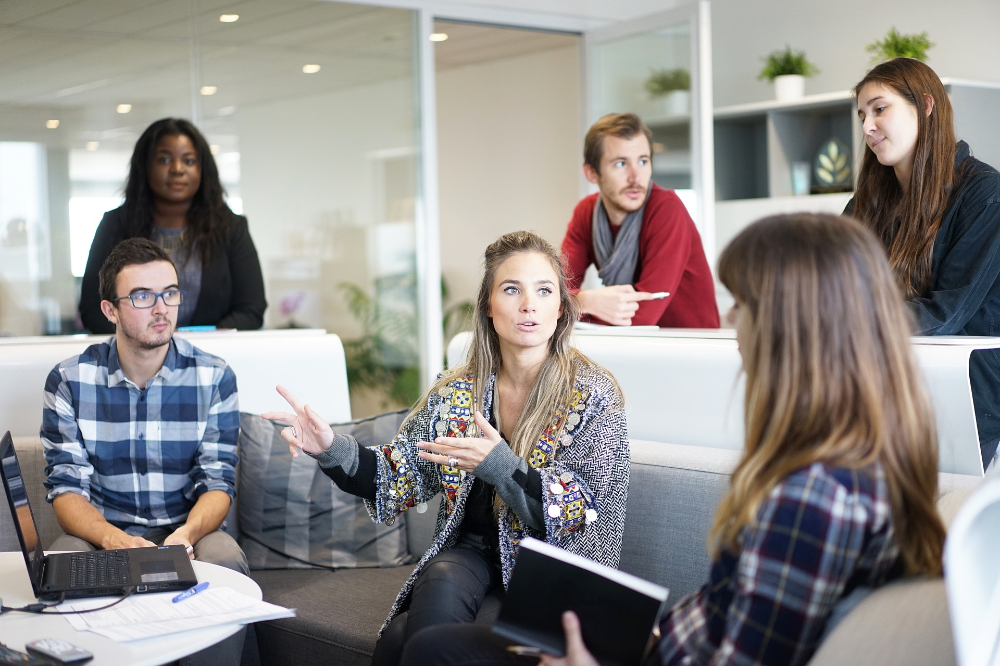

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow(imagem)

# Detectando Faces

In [ ]:
detector_face = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')

# Transformando a imagem em escala de cinza

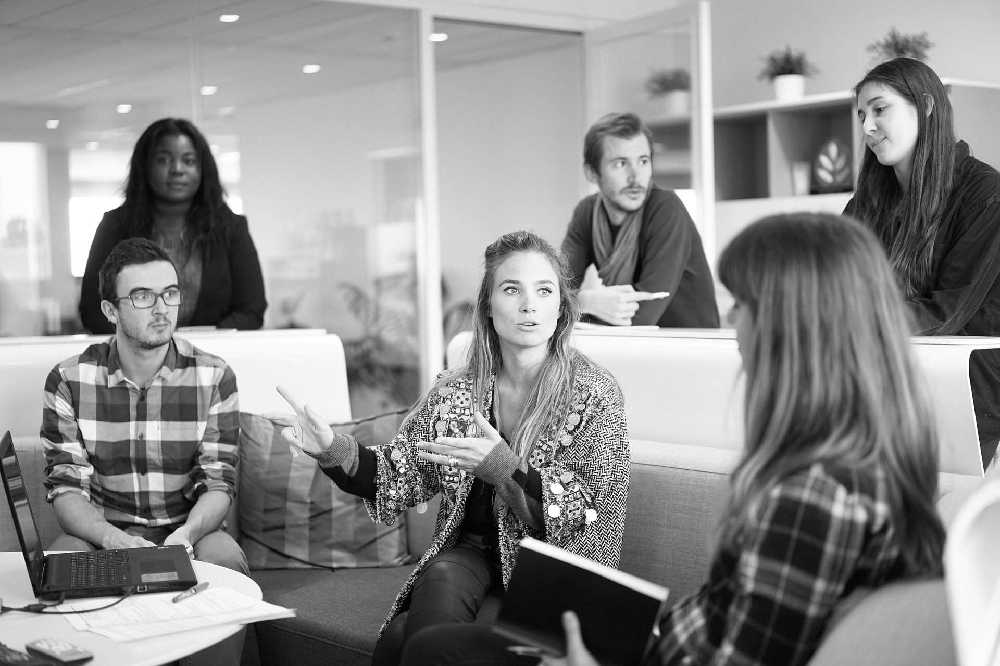

In [ ]:
imagem_cinza = cv2.cvtColor(imagem, cv2.COLOR_BGR2GRAY)
cv2_imshow(imagem_cinza)

# Gerando detecções

In [ ]:
deteccoes = detector_face.detectMultiScale(imagem_cinza, scaleFactor=1.3, minSize=(30,30))

In [ ]:
deteccoes

array([[ 282,  261,  117,  117],
       [1149,  260,  129,  129],
       [1628,  153,  157,  157],
       [ 929,  490,  171,  171],
       [ 222,  506,  151,  151],
       [ 104,  788,   53,   53]], dtype=int32)

In [ ]:
len(deteccoes)

6

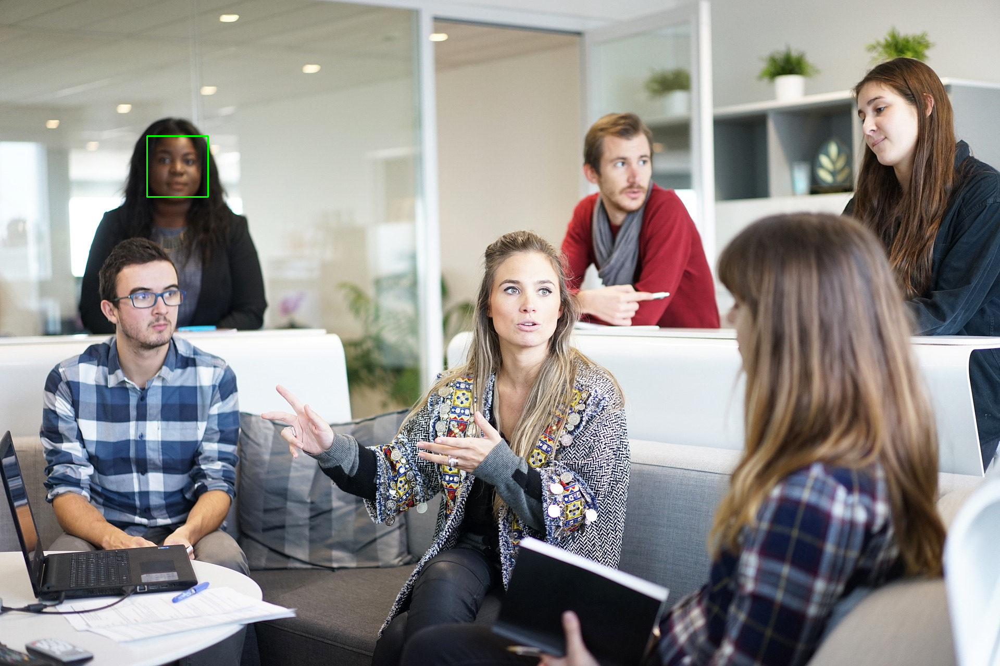

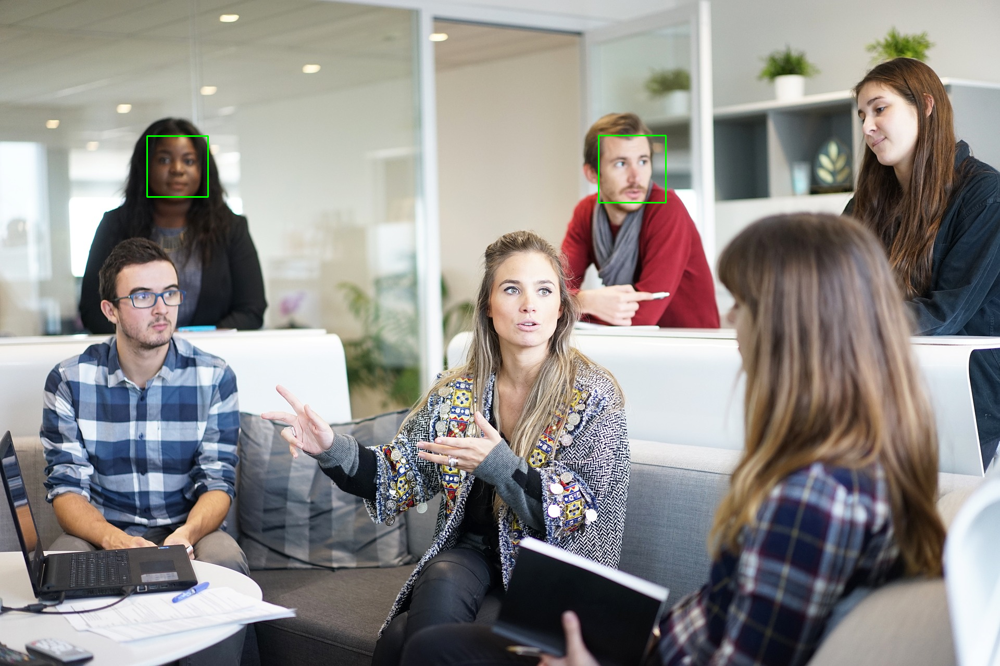

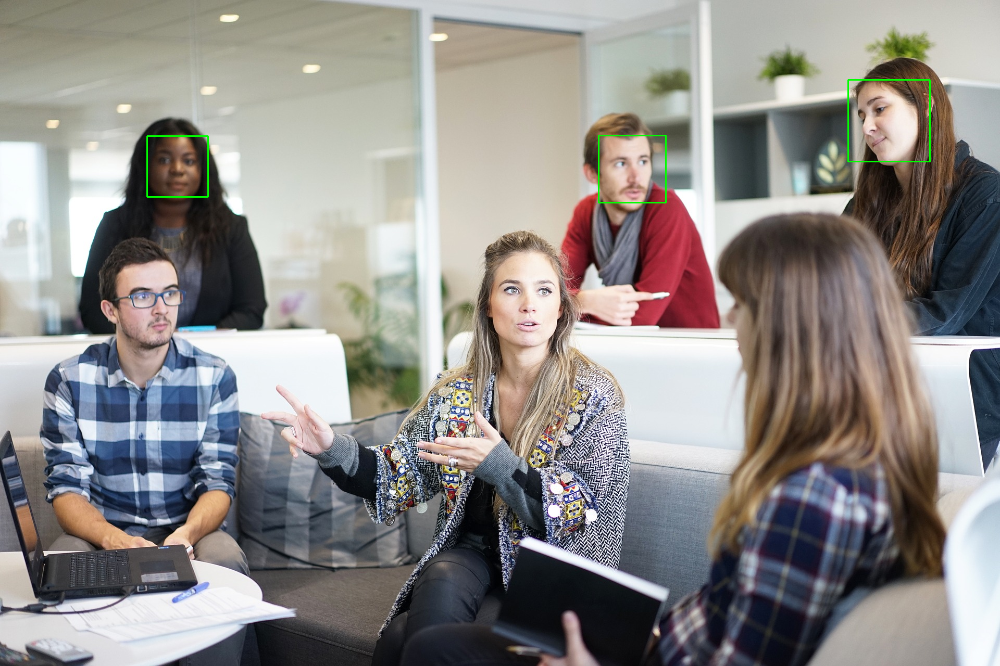

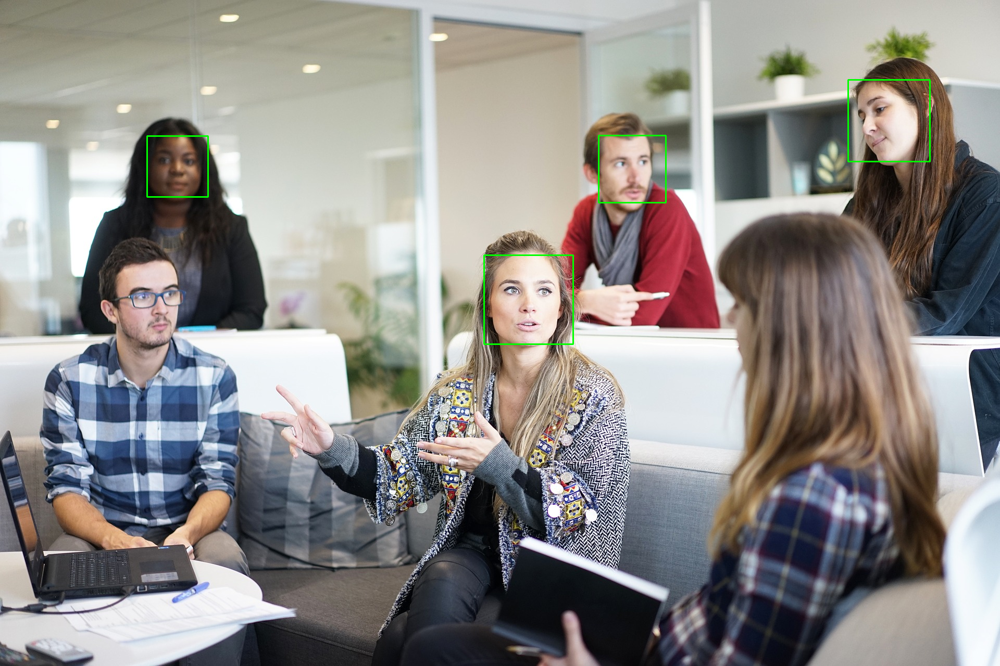

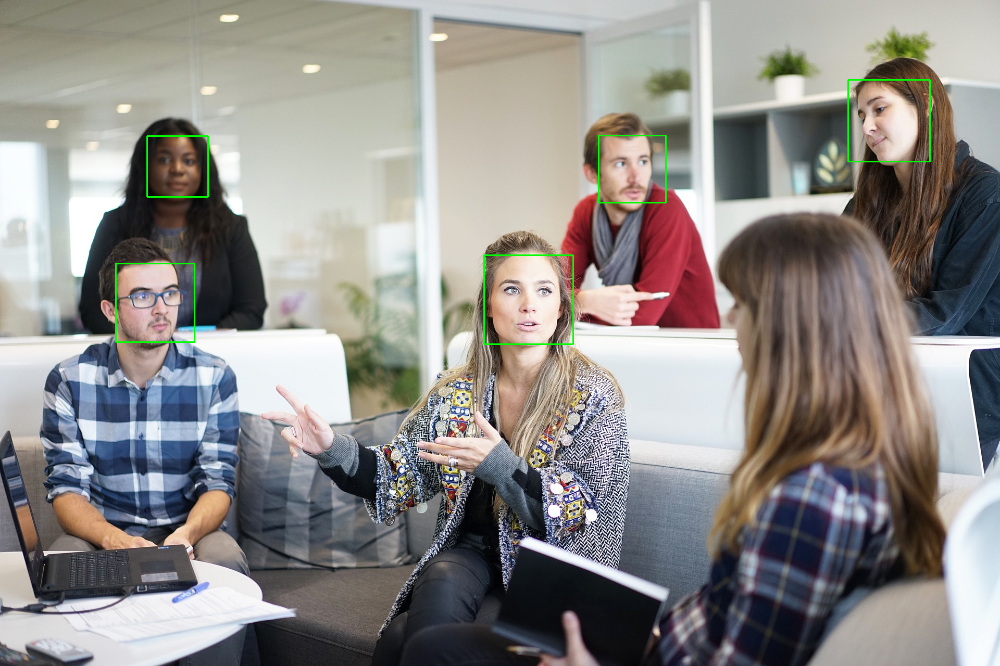

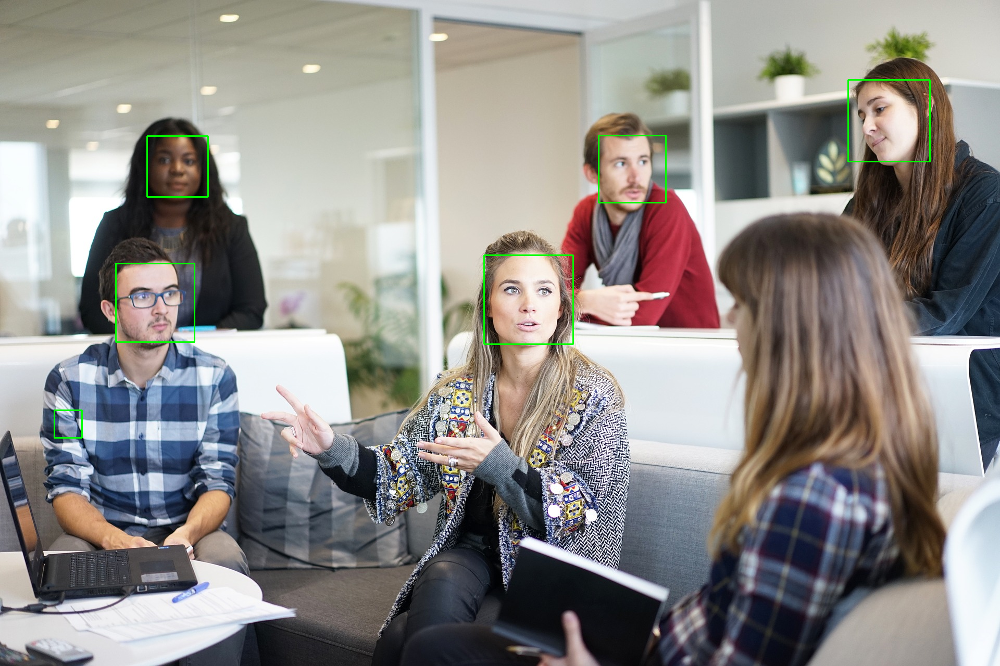

In [ ]:
for (x, y, l, a) in deteccoes:
  cv2.rectangle(imagem, (x, y), (x + l, y + a), (0, 255,0), 2)
  cv2_imshow(imagem)

##Detecção do Corpo

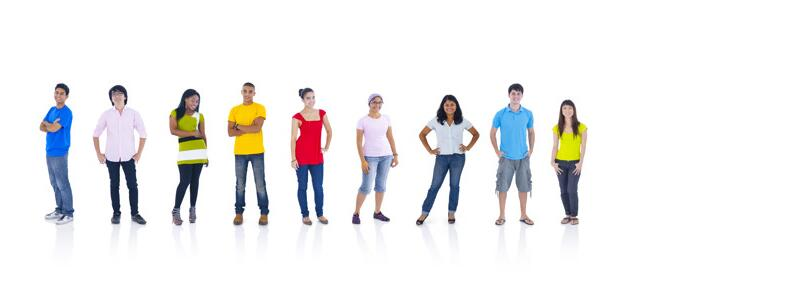

In [ ]:
imagem_corpo = cv2.imread('/content/pessoas .jpg')
cv2_imshow(imagem_corpo)

8
[[ 23  64  64 129]
 [201  50  95 189]
 [468  66  86 171]
 [273  86  72 143]
 [ 82  87  80 159]
 [333  72  79 158]
 [143  75  82 164]
 [531  92  72 145]]


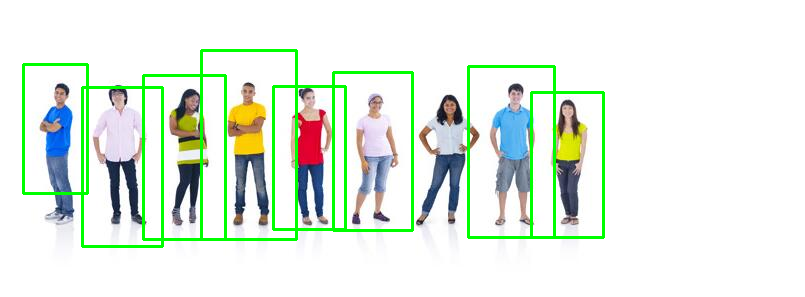

In [ ]:
detector_corpo = cv2.CascadeClassifier('/content/haarcascade_fullbody.xml')
image_gray = cv2.cvtColor(imagem_corpo, cv2.COLOR_BGR2GRAY)
detections = detector_corpo.detectMultiScale(image_gray, scaleFactor=1.1, minSize=(50,50))
print(len(detections))
print(detections)
for (x, y, l, a) in detections:
  cv2.rectangle(imagem_corpo, (x, y), (x + l, y + a), (0,255,0), 2)
cv2_imshow(imagem_corpo)

##Reconhecimento Facial

In [2]:
from PIL import Image
import numpy as np


# Montando o drive

In [18]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [21]:
import os
os.chdir("/content/drive/My Drive/dados")
!ls

yalefaces.zip


In [22]:
import zipfile
path = '/content/drive/MyDrive/dados/yalefaces.zip'
zip_object = zipfile.ZipFile(file=path, mode='r')
zip_object.extractall('./')
zip_object.close()

In [25]:
import os
os.listdir('/content/drive/MyDrive/dados/yalefaces/yalefaces')

['.DS_Store', 'test', 'train']

# Treinamento

In [26]:
def dados_imagem():
  caminhos = [os.path.join('/content/drive/MyDrive/dados/yalefaces/yalefaces/train', f) for f in os.listdir('/content/drive/MyDrive/dados/yalefaces/yalefaces/train')]
  faces = []
  ids = []
  for caminho in caminhos:
    if caminho == '/content/drive/MyDrive/dados/yalefaces/yalefaces/train.ipynb_checkpoints':
      continue
    imagem = Image.open(caminho).convert('L')
    imagem_np = np.array(imagem, 'uint8')
    id = int(os.path.split(caminho)[1].split('.')[0].replace('subject', ''))
    ids.append(id)
    faces.append(imagem_np)
  return np.array(ids), faces

In [27]:
ids, faces = dados_imagem()

In [28]:
print(ids)

[ 1  1  1  1  1  1  1  1  1  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3
  3  3  3  4  4  4  4  4  4  4  4  4  5  5  5  5  5  5  5  5  5  6  6  6
  6  6  6  6  6  6  7  7  7  7  7  7  7  7  7  8  8  8  8  8  8  8  8  8
  9  9  9  9  9  9  9  9  9 10 10 10 10 10 10 10 10 10 11 11 11 11 11 11
 11 11 11 12 12 12 12 12 12 12 12 12 13 13 13 13 13 13 13 13 13 14 14 14
 14 14 14 14 14 14 15 15 15 15 15 15 15 15 15]


In [29]:
print(faces[0])

[[130 130 130 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 252 255 255]
 [255 255 255 ... 255 255 255]
 [ 68  68  68 ...  68  68  68]]


In [30]:
lbph = cv2.face.LBPHFaceRecognizer_create()
lbph.train(faces, ids)
lbph.write('classificadorLBPH.yml')

##Classificação

In [31]:
# /content/drive/MyDrive/dados/classificadorLBPH.yml
reconhecedor = cv2.face.LBPHFaceRecognizer_create()
reconhecedor.read('/content/drive/MyDrive/dados/classificadorLBPH.yml')

In [32]:
# /subject10.sad.gif
imagem_teste = '/content/drive/MyDrive/dados/yalefaces/yalefaces/test/subject10.sad.gif'

In [33]:
imagem = Image.open(imagem_teste).convert('L')
imagem_np = np.array(imagem, 'uint8')
print(imagem_np)

[[130 130 130 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 241 255 255]
 [255 255 255 ... 234 237 252]
 [ 68  68  68 ...  68  68  68]]


In [34]:
idprevisto, _ = reconhecedor.predict(imagem_np)
idprevisto

10

In [35]:
idcorreto = int(os.path.split(imagem_teste)[1].split('.')[0].replace('subject', ''))
idcorreto

10

In [43]:
x, y = 0,0

In [47]:
from google.colab.patches import cv2_imshow

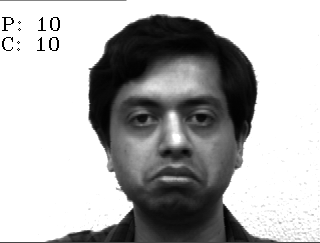

In [48]:
cv2.putText(imagem_np, 'P: ' + str(idprevisto), (x,y + 30), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0,255,0))
cv2.putText(imagem_np, 'C: ' + str(idcorreto), (x,y + 50), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0,255,0))
cv2_imshow(imagem_np)